# skspec Basic Tutorial: Part 1- TimeSpectra

### Objective

Introduce `TimeSpectra` and its basic features, including:

   - normalizing/referencing data (e.g. Absorbance vs. Transmitance)
    
   - changing spectral units
    
   - converting between interval and datetime representations
   
   - basic arithmetic/pandas operations
   
See [part 2](http://nbviewer.ipython.org/github/hugadams/skspec/blob/master/examples/Notebooks/tutorial_2.ipynb?create=1) for `TimeSpectra` construction, I/O, slicing and advanced pandas operations.

### Environment Setup

Configure notebook style (see NBCONFIG.ipynb), add imports and paths.  The **%run** magic used below <font color='red'>**requires IPython 2.0 or higher.**</font>

In [1]:
%run NBCONFIG.ipynb

Populating the interactive namespace from numpy and matplotlib
['dti', 'd', 'h', 'm', 'us', 's', 'ms', 'intvl', 'ns']


/home/adam/Enthought/Canopy_32bit/User/lib/python2.7/site-packages/IPython/nbformat/current.py:19: UserWarning: IPython.nbformat.current is deprecated.

- use IPython.nbformat for read/write/validate public API
- use IPython.nbformat.vX directly to composing notebooks of a particular version

  """)


### Importing Test Data

`skspec` comes prepackaged with several test datasets; see the [test data tutorial](http://nbviewer.ipython.org/github/hugadams/skspec/blob/master/examples/Notebooks/testdata.ipynb?create=1) for explanations of each set.  We will `aunps_glass()`, which is the spectral reflectance of a glass surface as it's coated with a monolayer of gold nanoparticles over time.

In [2]:
from skspec.data import aunps_glass

ts = aunps_glass()
ts

,2014-05-22 15:38:23,2014-05-22 15:38:26,2014-05-22 15:38:30,2014-05-22 15:38:34,2014-05-22 15:38:37,2014-05-22 15:38:41,2014-05-22 15:38:45,2014-05-22 15:38:48,2014-05-22 15:38:52,2014-05-22 15:38:56,...,2014-05-22 15:43:52,2014-05-22 15:43:56,2014-05-22 15:43:59,2014-05-22 15:44:03,2014-05-22 15:44:07,2014-05-22 15:44:10,2014-05-22 15:44:14,2014-05-22 15:44:18,2014-05-22 15:44:22,2014-05-22 15:44:25
430.10,257.315595,257.462298,257.216689,257.684547,257.415651,257.792816,257.591361,257.675306,257.857281,257.510473,...,65.671365,65.759080,64.799967,64.607195,64.664154,64.620006,65.493200,65.662877,66.519803,67.147343
430.47,267.776463,267.823164,267.707553,268.005419,267.876520,268.203698,268.092218,268.206170,268.248120,268.041360,...,68.311792,68.369461,67.330288,67.127725,67.264644,67.130501,67.993661,68.183516,69.130403,69.737849
430.85,278.697354,278.704053,278.718440,278.906314,278.837412,279.054604,279.073099,278.987057,279.048982,279.062270,...,70.792230,70.779853,69.730618,69.518269,69.625147,69.471009,70.284135,70.544173,71.551020,72.188368
431.22,290.288222,290.344919,290.219305,290.507185,290.428281,290.725485,290.633956,290.617920,290.679821,290.763156,...,73.572657,73.600234,72.550939,72.268798,72.325636,72.241504,72.984596,73.314811,74.301620,75.058874
431.59,302.609089,302.635784,302.620169,302.768056,302.789150,303.086367,303.004814,302.918784,303.010660,302.934043,...,76.773084,76.720616,75.651260,75.409328,75.356126,75.331998,76.135057,76.415450,77.462219,78.189380
431.96,314.499957,314.616650,314.641033,314.688928,314.840018,314.947249,315.075671,314.989648,315.011499,314.954929,...,79.643511,79.530997,78.471581,78.159858,78.186615,78.112493,78.915518,79.246089,80.342819,81.039885
432.33,327.720825,327.857516,327.931897,327.929799,328.070887,328.248131,328.296529,328.270511,328.322338,328.215816,...,82.863937,82.631379,81.571901,81.230387,81.317104,81.202988,82.045979,82.286728,83.383419,84.180391
432.70,340.491693,340.758382,340.682762,340.670670,340.861756,341.019013,341.057386,341.001375,341.083177,341.026702,...,85.934364,85.531760,84.502222,84.130917,84.257594,84.163482,85.016440,85.257367,86.344019,87.180897
433.08,355.492584,355.819271,355.763649,355.801565,355.992648,355.949918,356.248267,356.082262,356.274039,356.157613,...,89.454802,88.972152,88.022552,87.681461,87.808097,87.673990,88.466914,88.808023,89.834635,90.861416
433.45,369.703452,370.100137,370.154513,369.952437,370.273516,370.240800,370.539125,370.383125,370.534878,370.298499,...,92.845229,92.372533,91.352873,90.991991,91.108586,90.984485,91.797375,92.108662,93.175235,94.271922


A `timespectra` is a pandas Dataframe with a **DateTime Index** along the colum axis, and **Spectral Data** along the rows.  

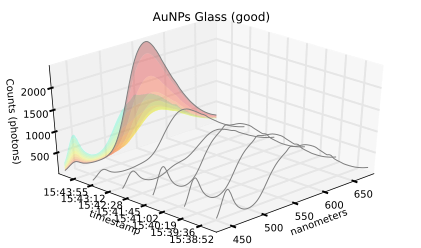

In [3]:
ts.plot(kind='spec3d');

### Spectral and Temporal Conversion

This previous plot shows the dataset, colored by time.  *What if we wanted to change the spectral dimension, and maybe represent the data as an interval?*  First, let's see what types of spectral units and time intervals are supported:

In [4]:
ts.specunits(pprint=True)
ts.varunits(pprint=True)


Key 	Description
-------------------

None 	No unit
cm 	centimeters
cm-1 	inverse centimeters
ev 	electron volts
f 	hertz
k 	inverse meters
m 	meters
nm 	nanometers
um 	microns
um-1 	inverse microns
w 	radians per second



Key 	Description
-------------------

None 	No unit
d 	days
dti 	timestamp
h 	hours
intvl 	interval
m 	minutes
ms 	milliseconds
ns 	nanoseconds
s 	seconds
us 	microseconds




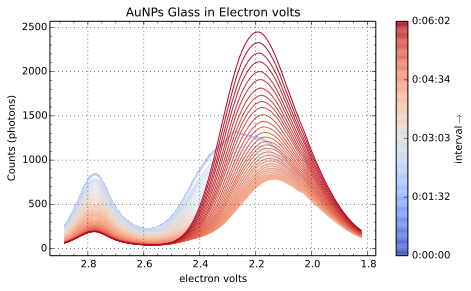

In [5]:
t2 = ts.as_varunit('intvl')
t2.specunit = 'ev'
t2.plot(cbar=True, 
        title='AuNPs Glass in Electron volts');

In [6]:
from skspec.correlation import Corr2d
from skspec.data import solvent_evap

Corr2d(solvent_evap()).async_codist.plot(contours=128)

(<matplotlib.axes.AxesSubplot at 0xb47ccec>,
 <matplotlib.axes.AxesSubplot at 0xbc787cc>)

By default, `as_interval()` returns time deltas, but we could also show this in seconds for example.  Let's look at how the area under the curves changes with time.

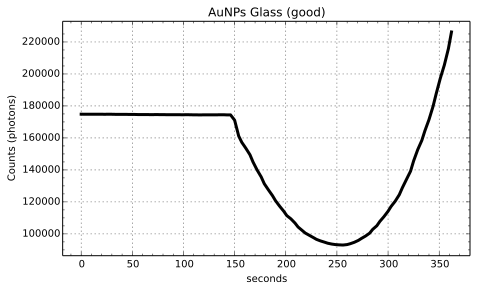

In [7]:
ts.as_varunit('s').plot(kind='area');

#### API for various units

`Spectra` object support the following three unit types:
 
   - **iunit**: Data intensity unit type ('Absorbance' vs. 'Transmittance' vs. 'Raw')
   - **specunit (index/row label)**: Spectral unit (wavelength, wavenumber etc...)
   - **varunit (column label)**: Variation/perturbation unit (time, temperature, pressure etc...)
   
While the most common perturbation variable in our work is time, a more general framework should not rely on explicit declarations of time.  

 <font color='blue'>**For each of these three units, the following API is supported**</font>:
   - `xunit`: Return the current unit.
       - e.g.  `ts.specunit`
   - `full_xunit`: Return the full name of spectral unit
       - e.g. `ts.full_specunit`
   - `list_xunits`: Formatted printout of all available units.
       - e.g. `ts.list_specunits()`
   - `as_xunit`: Return a new Spectra object in that desired unit
       - e.g. `ts_new = ts.as_specunit('nm')`
    
The API also supports unit setting (e.g. `ts.specunit = 'cm-1'`); however, setting the full specunit (e.g. `ts.full_specunit = inverse centimeters`) is not supported.

The `TimeSpectra` extends this API to support interval units.  For example, `ts.as_interval("s")`.  

#### Normalization and Intensity Representations

So far, we have only looked at the raw data.  However, spectrsocopy almost always deals with normalized data.  For example, the **absorbance** is defined as:

$A(\lambda) = -\log_{10} \left[ \frac{S(\lambda)  - B(\lambda) }{R(\lambda)  - B(\lambda) }\right] $

Where **S** is the spectra, **R** is a reference spectrum and **B** is a baseline spectra.  Because baseline and reference operations are SO common, `skspec` tries to make juggling them very intuitive.

Let's check out the supported normalizations:

In [8]:
ts.norms(pprint=True)


Key 	Description
-------------------

None 	No Normalization
%t 	(%)Transmittance
a 	Absorbance (base 10)
a(ln) 	Absorbance (base e)
r 	Inverse Transmittance (1/T)
t 	Transmittance




Note the **Inverse Transmittance**.  This merely means dividing the baseline-subtracted data by a single curve (eg. it's $A(\lambda)$ without the $-log_{10}$).   Let's take a look at the absorbance using a dataset of AuNPs in $H_20$.  We will plot the dataset, its reference and its baseline (which has been pre-assigned) in a multiplot using `splot`, as simple wrapper to matplotlib's `plt.subplots()`.

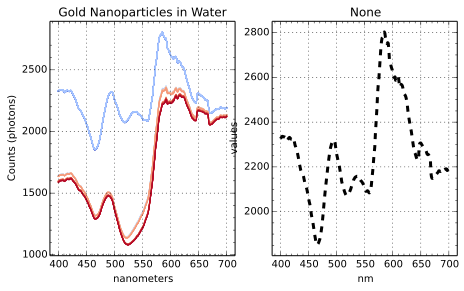

In [9]:
from skspec.data import aunps_water
from skspec.plotting import splot

ts_water = aunps_water().ix[400.:700.] #Focus on visible wavelengths 
ax1, ax2 = splot(1,2)

ts_water.plot(ax=ax1)
ts_water.baseline.plot(ax = ax2, color='r', ls='--')
ts_water.reference.plot(ax = ax2, color='black', ls='--');

We see that the baseline for this dataset is set to $y=234 counts$ and the reference is actually the first curve in the dataset.  **Before using normalized data, don't to subtract the baseline!**.  The baseline can be subtracted or added back at any time through the `ts.sub_base()` and `ts.add_base()` methods.  The plot below shows the characteristic surface plasmon resonance peak of gold nanoparticles before and after proteins bind to them.

CRITICAL:skspec.core.spectra:Subtracting baseline, but may not have all: elements being equal.  Fix index


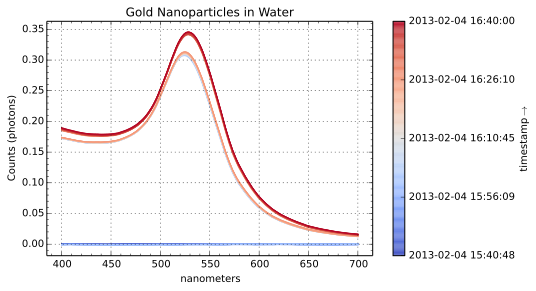

In [10]:
ts_water.sub_base()
ts_water.as_norm('a').plot(cbar=True, colormap='hot_r');

#### Changing the baseline/reference

Baselines and references accept a variety of input types including:

- `Column Index` : **ts.set_baseline(50)**
       Integers are automatically interpreted as column indicies.

- `Column Name` : **ts.set_baseline('2013-02-04 15:40:48')**
       Strings must be valid column names.
       
- `Array` : **ts.set_baseline(np.random.randn( ts.shape[0] )**
       Array must have the SAME length as ts.index
       
       
For example, let's pass some guassian noise as our baseline, then subtract the baseline resulting in really noisy data.

CRITICAL:skspec.core.spectra:Subtracting baseline, but may not have all: elements being equal.  Fix index


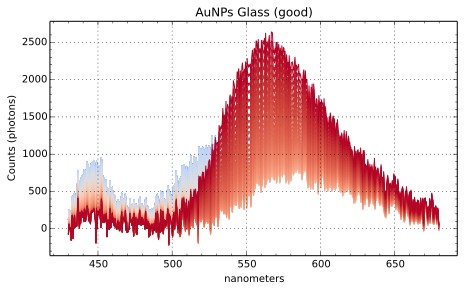

In [11]:
AMP = 100 #noise amplitude
ts.baseline = AMP * np.random.randn(ts.shape[0])
ts.sub_base()
ts.plot();

**However, this operation is fully reversible!**

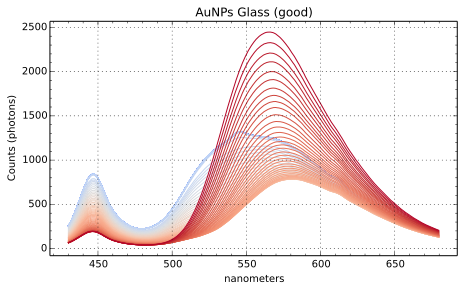

In [12]:
ts.add_base()
ts.plot();

### Arithmetic Operations 

The timespectra should behave like a dataframe, so basic [pandas](http://pandas.pydata.org/) operations should just work.  Note that this behavior is not standard, so not every single operation is likely to work.   <font color='blue'>**At any time, the underlying dataframe may be access through the attribute,**</font> `ts._df()`.

As an example of an arithmetic operation, let's square the TimeSpectra...

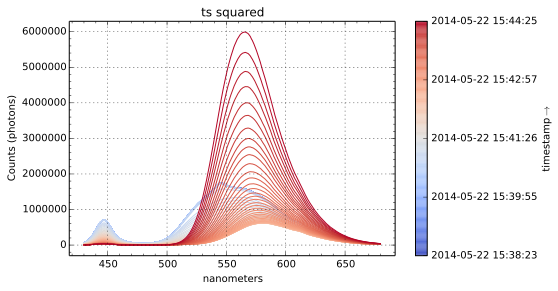

In [13]:
tsquared = ts**2
tsquared.plot(title='ts squared',
              cbar = True,
              colormap='spectral');

or look at the column-wise mean... ( <font color='red'>some operations that return will lose some skspec of the default plot settings</font>)

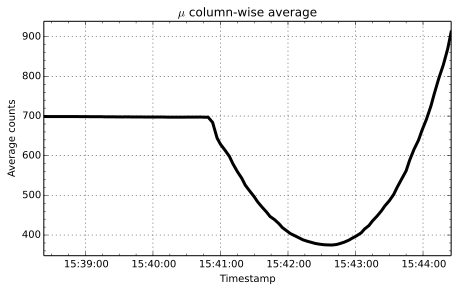

In [14]:
ts.mean().plot(title='$\mu$ column-wise average')
plt.ylabel('Average counts')
plt.xlabel('Timestamp');

One very important method is `ts.apply()` which allows the user to pass an arbitrary curve function row or columnwise.  As a contrived example, consider a function that randomly adds noise to a curve with a 20% chance.

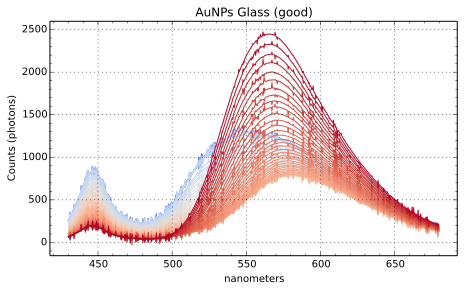

In [15]:
def random_noise(curve):
    if randint(1,6) == 5:     #20% chance of choosing 5
        curve = curve + 25 * np.random.randn(len(curve))
    return curve

ts_noisy = ts.apply(random_noise, axis=1)
ts_noisy.plot();

`apply` also works on functions that will return a single `Spectrum`.  For example, if we define a function that for each time curve, we return the quotient of its min and max, a `Spectrum` is returned.  This is equivalent to a pandas Series, except it retains certain metadata about the `Spectra` such as the `specunit` and baseline.

<class 'skspec.core.spectra.Spectrum'>


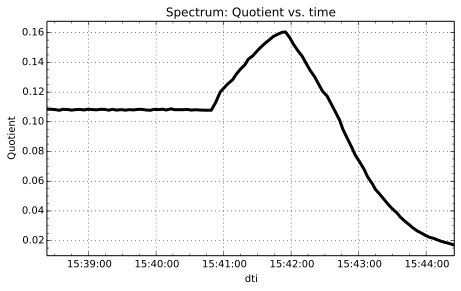

In [16]:
def foo(series):
    return series.min() /series.max()

spectrum = ts.apply(foo)
spectrum.plot(ylabel='Quotient', title='Spectrum: Quotient vs. time')
print type(spectrum)

# Print out first 5 values
spectrum[0:5];

See [part2](http://nbviewer.ipython.org/github/hugadams/skspec/blob/master/examples/Notebooks/tutorial_2.ipynb?create=1) for slicing, IO and more advanced pandas functionality.  For working with multiple TimeSpectra at once, jump to the [SpecStack tutorial](http://nbviewer.ipython.org/github/hugadams/skspec/blob/master/examples/Notebooks/testdata.ipynb?create=1).

<hr>
<br>


<div style="float:left; \">
    <img src="https://avatars0.githubusercontent.com/u/1972276?s=460" 
 align=left; text-align:center; style="float:left; margin-left: 5px; margin-top: -25px; width:150px; height:150px" /> 
</div>

<div style="float:left; \"><a href="https://github.com/hugadams">
    <img src="https://assets-cdn.github.com/images/modules/logos_page/GitHub-Mark.png" 
 align=left; text-align:center; style="float:left; margin-left: 25px; margin-top: -25px; width:75px; height:75px" /> 
</div>


<div style="float:left; \"><a href="https://twitter.com/hughesadam87">
    <img src="http://paymentmagnates.com/wp-content/uploads/2014/04/twitter-icon.png" 
 align=left; text-align:center; style="float:left; margin-left: 25px; margin-top: -25px; width:75px; height:75px" /> 
</div>

<div style="float:left; \"><a href="https://www.researchgate.net/profile/Adam_Hughes2?ev=hdr_xprf">
    <img src="http://www.txhughes.com/images/button-researchgate.png" 
 align=left; text-align:center; style="float:left; margin-left: -175px; margin-top: 55px; width:75px; height:75px" /> 
</div>

<div style="float:left; \"><a href="https://www.linkedin.com/profile/view?id=121484744&trk=nav_responsive_tab_profile_picg">
    <img src="http://smallbusinessesdoitbetter.com/wordpress/wp-content/uploads/li.png" 
 align=left; text-align:center; style="float:left; margin-left: -75px; margin-top: 55px; width:75px; height:75px" /> 
</div>

<div style="float:center; \"><a href="http://www.gwu.edu/">
    <img src="https://raw.githubusercontent.com/hugadams/pyparty/master/pyparty/data/gwu.png" 
 align=center style="float:center; margin-right: 30px; margin-top: -35px; width:335px; height:180px" />
</div>


<h4 style="margin-top:0px;"> This notebook is free for redistribution. If citing, please reference as: </h4>
- *Hughes, A. (2012). [A Computational Framework for Plasmonic Nanobiosensing](https://www.researchgate.net/publication/236672995_A_Computational_Framework_for_Plasmonic_Nanobiosensing).  Python in Science Conference [SCIPY].* 


<h3 style="margin-top:30px;"> Questions or Feedback? </h3>

* hugadams@gwmail.gwu.edu 
* twitter:  <a href="https://twitter.com/hughesadam87" target="_blank">@hughesadam87</a>
* <a href="http://www.gwu.edu/~condmat/CME/reeves.html" target="_blank">Mark Reeves Biophysics Group</a>




<h3 style="margin-top:30px;"> References: </h3>

* [1] : **REF 1**
* [2] : **REF 2**





<h3 style="margin-top:30px;"> Related: </h3>

   * <a href="https://github.com/hugadams/pyparty" target="_blank">skspec: Exploratory Spectral Data Analysis</a>
   * <a href="https://github.com/hugadams/pyparty" target="_blank">pyparty: Image Analysis of Particles</a>
   * <a href="http://lorenabarba.com/" target="_blank">Lorena A. Barba (GWU Engineering)</a>
   * <a href="http://www.youtube.com/watch?v=W7RgkHM-B60" target="_blank">xray: extended arrays for scientific datasets</a>



<h3 style="margin-top:30px;">Notebook styling ideas:</h3>

* <a href="http://blog.louic.nl/?p=683" target="_blank">Louic's web blog</a>
* <a href="https://plot.ly/feed" target="_blank">Plotly</a>
* <a href="http://damon-is-a-geek.com/publication-ready-the-first-time-beautiful-reproducible-plots-with-matplotlib.html" target="_blank">Publication-ready the first time: Beautiful, reproducible plots with Matplotlib</a>

<br>
<hr>